# Analysis of results extracted with Gradient Boosting + Complexity Measures

In this notebook we are going to compare the results (accuracy and function loss (log-loss and exponential)) obtained with all the different options we have tested:
* Classic Gradient Boosting with both loss functions (exponential and log_loss)
* Gradient Boosting with weights modified by complexity measures. In particular, we introduce the complexity of every instance in the loss function in the following way:
$L(f) = \sum_{i=1}^{n} w_i \cdot l(y_i,f(x_i))$ where $w_i$ is the complexity of every instance according to a complexity measure.
In the case of exponential loss:
* $L(f) = \sum_{i=1}^{n} w_i \cdot exp(-y_i f(x_i))$
In the case of log-loss:
* $L(f) = \sum_{i=1}^{n} w_i \cdot log(1 + e^{-y_i f(x_i)})$
We obtain results with both loss functions and multiplying the complexity values with a factor. Therefore, we have 4 options: sample_weight_easy, sample_weight_easy_x2, sample_weight_hard, sample_weight_hard_x2.

If we add the complexity information as a regularization term, for example:
$L(f) = \sum_{i=1}^{n} w_i \cdot l(y_i,f(x_i)) + \lambda \cdot c(x_i)$
being $c(x_i)$ the complexity information. This term has to depend on $f(x_i)$ because if not, when calculating the derivative, it will be 0. Obviously, complexity measures are in terms of $x_i$ but, the way we are using them, they are just fixed values.



In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import glob
import math
from All_measures import all_measures


os.chdir("..")
root_path = os.getcwd()

In [2]:
path_csv = os.path.join(root_path, 'Results_GB')
os.chdir(path_csv)


In [3]:
#colour_palette_personalized = ["#FFD700", "#00CED1", "#FF1493","#F1F1F1"]
colour_palette_personalized = {
    "classic": "#FFD700",   # yellow
    "sample_weight_easy": "#C7F7FF", # blue
    "sample_weight_easy_x2": "#00CED1", # blue
    "sample_weight_hard": "#FFB3DA",    # magenta
    "sample_weight_hard_x2": "#FF1493",    # magenta
    "error_w_easy_0.025": "#91E2B1" ,    # green
    "error_w_easy_0.05": "#03682B" ,    # green
    "error_w_hard_0.025": "#E0B3FF" ,    # violet
    "error_w_hard_0.05": "#9701FF" ,    # violet
    # "Classic": "#FFD700",   # yellow
    # "Easy": "#00CED1", # blue
    # "Hard": "#FF1493",    # magenta
}


# Analysis aggregating results for all datasets

We perform this analysis for all the datasets now. We read all the csv and we aggregate the results to obtain a general overview.

In [4]:
specific_path = os.path.join(path_csv, '*Aggregated*.csv')
selected_files = glob.glob(specific_path)
all_datasets = pd.concat([pd.read_csv(f) for f in selected_files], ignore_index=True)

In [5]:
all_datasets.reset_index()
all_datasets.shape

(976800, 15)

We aggregate all the results by calculating mean, median and standard deviation of loss function, train accuracy and test accuracy

In [6]:
all_gb = all_datasets.groupby(['n_ensemble', 'method_weights', 'compl_measure','loss_selected']).agg(
    loss_test_avg_mean=('loss_test_mean', 'mean'),
    loss_test_avg_median=('loss_test_mean', 'median'),
    loss_test_avg_std=('loss_test_mean', 'std'),
    train_acc_mean_mean=('train_acc_mean', 'mean'),
    train_acc_mean_median=('train_acc_mean', 'median'),
    train_acc_mean_std=('train_acc_mean', 'std'),
    test_acc_mean_mean=('test_acc_mean', 'mean'),
    test_acc_mean_median=('test_acc_mean', 'median'),
    test_acc_mean_std=('test_acc_mean', 'std')
).reset_index()

In [7]:
all_gb.head()

,n_ensemble,method_weights,compl_measure,loss_selected,loss_test_avg_mean,loss_test_avg_median,loss_test_avg_std,train_acc_mean_mean,train_acc_mean_median,train_acc_mean_std,test_acc_mean_mean,test_acc_mean_median,test_acc_mean_std
0,1,classic,none,exponential,1.030377,1.053045,0.132883,0.645144,0.635582,0.101271,0.643105,0.635644,0.102818
1,1,classic,none,log_loss,0.633121,0.636519,0.046690,0.646712,0.635582,0.100031,0.644187,0.635644,0.101887
2,1,sample_weight_easy,CLD,exponential,1.167498,1.189120,0.352958,0.610227,0.619364,0.086414,0.608105,0.619728,0.085258
3,1,sample_weight_easy,CLD,log_loss,0.696036,0.683550,0.066508,0.611046,0.619364,0.087065,0.608921,0.619728,0.085685
4,1,sample_weight_easy,DCP,exponential,1.095732,1.090954,0.274003,0.628433,0.628777,0.095933,0.626180,0.628380,0.096876


In [17]:
# all_gb = all_datasets.groupby(['method_weights', 'compl_measure','loss_selected']).agg(
#     loss_test_avg_mean=('loss_test_mean', 'mean'),
#     loss_test_avg_median=('loss_test_mean', 'median'),
#     loss_test_avg_std=('loss_test_mean', 'std'),
#     train_acc_mean_mean=('train_acc_mean', 'mean'),
#     train_acc_mean_median=('train_acc_mean', 'median'),
#     train_acc_mean_std=('train_acc_mean', 'std'),
#     test_acc_mean_mean=('test_acc_mean', 'mean'),
#     test_acc_mean_median=('test_acc_mean', 'median'),
#     test_acc_mean_std=('test_acc_mean', 'std')
# ).reset_index()
# all_gb.to_csv('All_results_GB_Averaged_per_Dataset.csv', index=False)

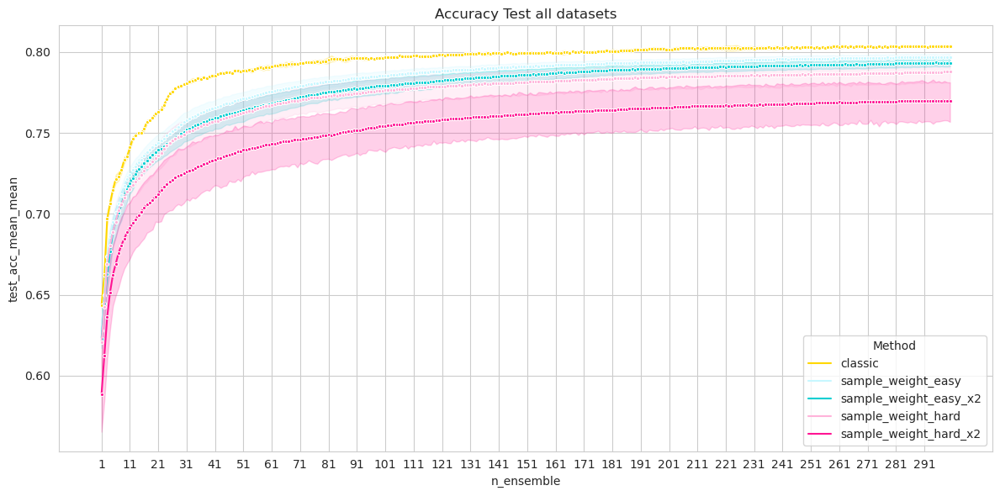

In [20]:
plt.figure(figsize=(12, 6))

sns.lineplot(data=all_gb, x='n_ensemble', y='test_acc_mean_mean', hue='method_weights', errorbar=('ci', 95), marker='.',
             palette=colour_palette_personalized) #  errorbar=(None)

plt.title('Accuracy Test all datasets')
plt.xlabel('n_ensemble')
plt.ylabel('test_acc_mean_mean')
plt.legend(title='Method')
plt.xticks(ticks=range(1, 301, 10)) 
plt.grid(True)
plt.tight_layout()
plt.show()

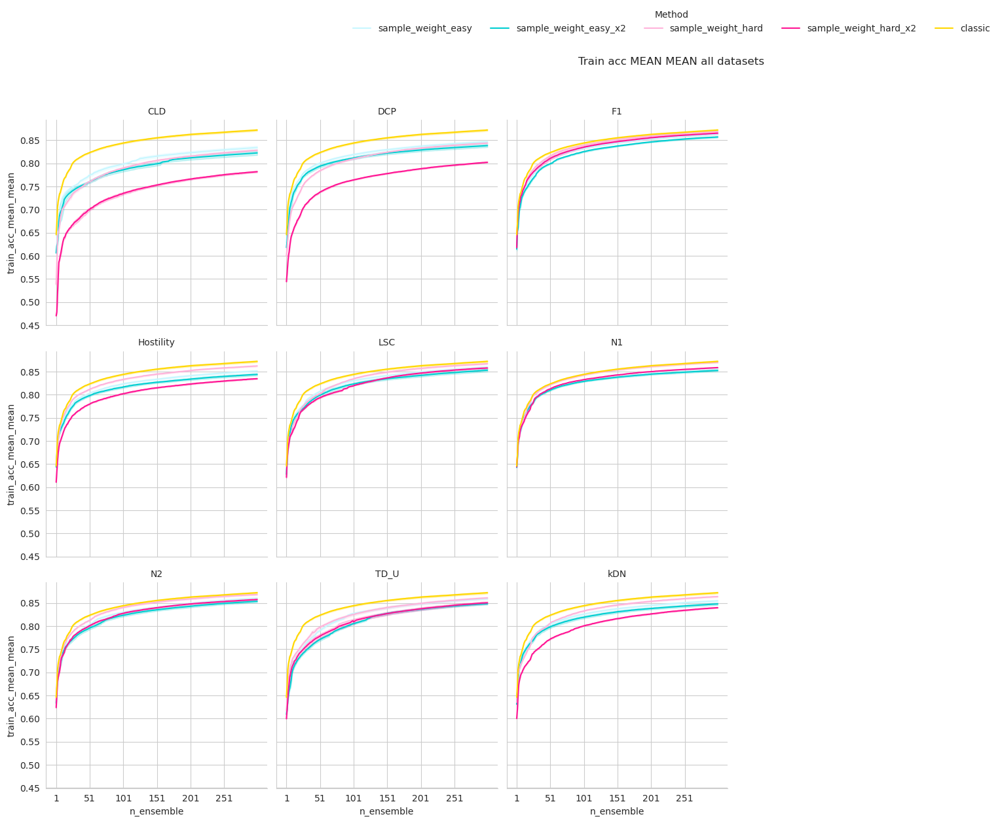

In [21]:
df_complete_all = []

for compl in all_gb[all_gb['method_weights'] != "classic"]['compl_measure'].unique():
    df_subset = all_gb[all_gb['compl_measure'] == compl]

    df_complete_all.append(df_subset)

    classic_data = all_gb[(all_gb['method_weights'] == "classic") & (all_gb['compl_measure'] == "none")].copy()
    classic_data['compl_measure'] = compl
    df_complete_all.append(classic_data)

df_complete_all = pd.concat(df_complete_all)

g = sns.FacetGrid(df_complete_all, col="compl_measure", hue="method_weights", col_wrap=3, height=4, palette=colour_palette_personalized)

g.map(sns.lineplot, 'n_ensemble', 'train_acc_mean_mean')

g.set_titles("{col_name}")
g.set_axis_labels("n_ensemble", "train_acc_mean_mean")
g.add_legend(title="Method", loc='upper center', bbox_to_anchor=(0.5, 1.05), ncol=5, frameon=False)

for ax in g.axes.flat:
    ax.set_xticks(range(1, 301, 50))
    ax.grid(True)

plt.subplots_adjust(top=0.9)
g.fig.suptitle('Train acc MEAN MEAN all datasets')
plt.show()

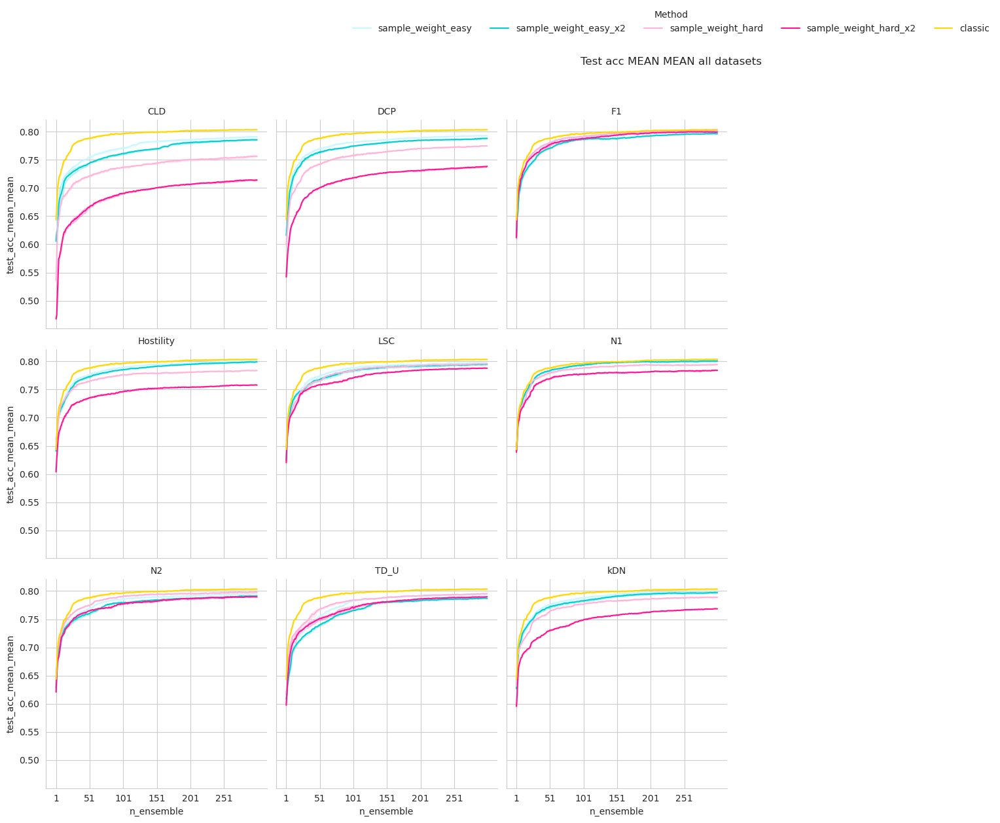

In [22]:
g = sns.FacetGrid(df_complete_all, col="compl_measure", hue="method_weights", col_wrap=3, height=4, palette=colour_palette_personalized)

g.map(sns.lineplot, 'n_ensemble', 'test_acc_mean_mean')

g.set_titles("{col_name}")
g.set_axis_labels("n_ensemble", "test_acc_mean_mean")
g.add_legend(title="Method", loc='upper center', bbox_to_anchor=(0.5, 1.05), ncol=5, frameon=False)

for ax in g.axes.flat:
    ax.set_xticks(range(1, 301, 50))
    ax.grid(True)

plt.subplots_adjust(top=0.9)
g.fig.suptitle('Test acc MEAN MEAN all datasets')
plt.show()

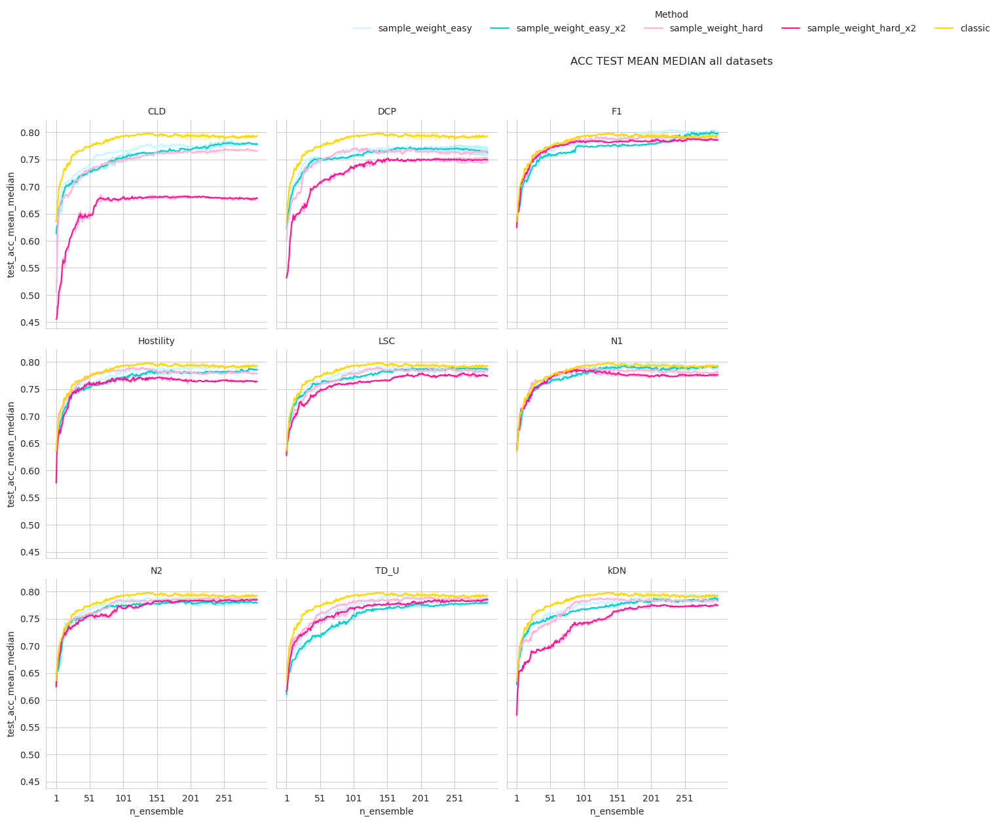

In [23]:
g = sns.FacetGrid(df_complete_all, col="compl_measure", hue="method_weights", col_wrap=3, height=4, palette=colour_palette_personalized)

g.map(sns.lineplot, 'n_ensemble', 'test_acc_mean_median')

g.set_titles("{col_name}")
g.set_axis_labels("n_ensemble", "test_acc_mean_median")
g.add_legend(title="Method", loc='upper center', bbox_to_anchor=(0.5, 1.05), ncol=5, frameon=False)

for ax in g.axes.flat:
    ax.set_xticks(range(1, 301, 50))
    ax.grid(True)

plt.subplots_adjust(top=0.9)
g.fig.suptitle('ACC TEST MEAN MEDIAN all datasets')
plt.show()

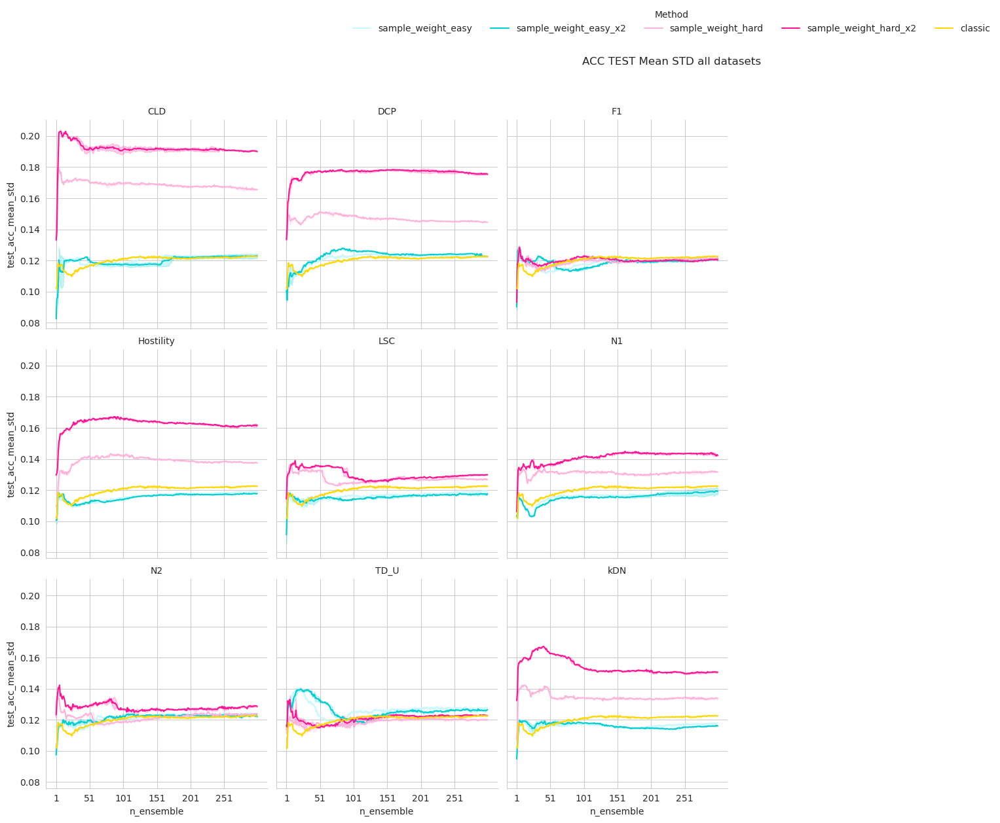

In [24]:
g = sns.FacetGrid(df_complete_all, col="compl_measure", hue="method_weights", col_wrap=3, height=4, palette=colour_palette_personalized)

g.map(sns.lineplot, 'n_ensemble', 'test_acc_mean_std')

g.set_titles("{col_name}")
g.set_axis_labels("n_ensemble", "test_acc_mean_std")
g.add_legend(title="Method", loc='upper center', bbox_to_anchor=(0.5, 1.05), ncol=5, frameon=False)

for ax in g.axes.flat:
    ax.set_xticks(range(1, 301, 50))
    ax.grid(True)

plt.subplots_adjust(top=0.9)
g.fig.suptitle('ACC TEST Mean STD all datasets')
plt.show()

In [45]:
# Tabla de mediana, std y media total
summary_results = all_datasets.groupby(['dataset', 'method_weights']).agg(
    misc_rate_test_mean_median=('misc_rate_test_mean', 'median'),
    misc_rate_test_mean_std=('misc_rate_test_mean', 'std'),
    misc_rate_test_mean_total_mean=('misc_rate_test_mean', 'mean')
).reset_index()

# Pivotar para obtener una tabla más organizada
summary_pivot = summary_results.pivot(index='dataset', columns='method_weights', 
                                      values=['misc_rate_test_mean_median', 'misc_rate_test_mean_std', 'misc_rate_test_mean_total_mean'])

# Renombrar columnas para que sean más fáciles de leer
summary_pivot.columns = [f'{method}_{stat}' for stat, method in summary_pivot.columns]
summary_pivot.reset_index(inplace=True)



In [46]:
summary_pivot

,dataset,classic_misc_rate_test_mean_median,error_w_easy_0.025_misc_rate_test_mean_median,error_w_easy_0.05_misc_rate_test_mean_median,error_w_hard_0.025_misc_rate_test_mean_median,error_w_hard_0.05_misc_rate_test_mean_median,init_easy_misc_rate_test_mean_median,init_easy_x2_misc_rate_test_mean_median,init_hard_misc_rate_test_mean_median,init_hard_x2_misc_rate_test_mean_median,...,init_hard_x2_misc_rate_test_mean_std,classic_misc_rate_test_mean_total_mean,error_w_easy_0.025_misc_rate_test_mean_total_mean,error_w_easy_0.05_misc_rate_test_mean_total_mean,error_w_hard_0.025_misc_rate_test_mean_total_mean,error_w_hard_0.05_misc_rate_test_mean_total_mean,init_easy_misc_rate_test_mean_total_mean,init_easy_x2_misc_rate_test_mean_total_mean,init_hard_misc_rate_test_mean_total_mean,init_hard_x2_misc_rate_test_mean_total_mean
0,WineQualityRed_5vs6,0.288145,0.288139,0.288127,0.288127,0.288127,0.293407,0.292661,0.302556,0.322244,...,0.076750,0.291635,0.290530,0.290997,0.290866,0.290866,0.296535,0.297416,0.322798,0.362849
1,Yeast_CYTvsNUC,0.341948,0.341960,0.341960,0.341998,0.341998,0.347591,0.346429,0.354220,0.378914,...,0.071196,0.343420,0.343814,0.343593,0.343774,0.343774,0.351851,0.352899,0.379240,0.416069
2,arrhythmia_cfs,0.167874,0.169952,0.170048,0.167923,0.167923,0.190097,0.201256,0.192271,0.214348,...,0.045707,0.175926,0.176264,0.176926,0.175817,0.175817,0.200795,0.211091,0.205838,0.224003
3,bands,0.312162,0.306832,0.309459,0.306907,0.306907,0.309760,0.320871,0.322973,0.336637,...,0.043075,0.310373,0.306765,0.308202,0.307863,0.307863,0.313494,0.323123,0.329404,0.347885
4,banknote_authentication,0.001455,0.001455,0.001455,0.001455,0.001455,0.003639,0.004369,0.001455,0.002184,...,0.022414,0.006518,0.006522,0.006508,0.006502,0.006502,0.009268,0.011190,0.007210,0.008665
5,bodyfat,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,...,0.000000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000,0.004000
6,breast-w,0.041470,0.042899,0.041470,0.042899,0.042899,0.041491,0.044286,0.038613,0.039317,...,0.007155,0.042521,0.043111,0.042790,0.043655,0.043655,0.043453,0.044876,0.040182,0.040365
7,breastcancer,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,bupa,0.266765,0.266723,0.266723,0.266639,0.266639,0.275462,0.286975,0.284580,0.295462,...,0.051043,0.271157,0.270870,0.270289,0.270628,0.270628,0.283093,0.293788,0.297010,0.313571
9,chatfield_4,0.127717,0.127899,0.127717,0.127717,0.127717,0.131703,0.132065,0.136232,0.136413,...,0.008611,0.126237,0.128773,0.127085,0.127507,0.127507,0.130807,0.129906,0.135866,0.137667


We obtain mean, median and std per complexity measure

In [29]:
def summary_CM(CM,dataset):
    all_datasets_CM = dataset.loc[(dataset.compl_measure == CM) | (dataset.compl_measure == 'none'),:]
    summary_results = all_datasets_CM.groupby(['dataset', 'method_weights']).agg(
        test_acc_mean_median=('test_acc_mean', 'median'),
        test_acc_mean_std=('test_acc_mean', 'std'),
        test_acc_mean_total_mean=('test_acc_mean', 'mean')
    ).reset_index()

    # Pivotar para obtener una tabla más organizada
    summary_pivot = summary_results.pivot(index='dataset', columns='method_weights',
                                          values=['test_acc_mean_median', 'test_acc_mean_std', 'test_acc_mean_total_mean'])

    # Renombrar columnas para que sean más fáciles de leer
    summary_pivot.columns = [f'{method}_{stat}' for stat, method in summary_pivot.columns]
    summary_pivot.reset_index(inplace=True)
    return summary_pivot



In [30]:
def plot_summary_CM(CM,summary_table_CM):
    summary_long = summary_table_CM.melt(id_vars='dataset',
                                        value_vars=[
                                            'classic_test_acc_mean_median',
                                            'sample_weight_easy_test_acc_mean_median',
                                            'sample_weight_easy_x2_test_acc_mean_median',
                                            'sample_weight_hard_test_acc_mean_median',
                                            'sample_weight_hard_x2_test_acc_mean_median',
                                            'classic_test_acc_mean_std',
                                            'sample_weight_easy_test_acc_mean_std',
                                            'sample_weight_easy_x2_test_acc_mean_std',
                                            'sample_weight_hard_test_acc_mean_std',
                                            'sample_weight_hard_x2_test_acc_mean_std',
                                             'classic_test_acc_mean_total_mean',
                                            'sample_weight_easy_test_acc_mean_total_mean',
                                            'sample_weight_easy_x2_test_acc_mean_total_mean',
                                            'sample_weight_hard_test_acc_mean_total_mean',
                                            'sample_weight_hard_x2_test_acc_mean_total_mean',
                                        ],
                                        var_name='method_stat',
                                        value_name='value')

    # Separar los nombres de métod y estadístico
    summary_long[['method', 'statistic']] = summary_long['method_stat'].str.rsplit('_', n=1, expand=True)
    summary_long['method'] = summary_long['method'].replace({
        'classic_test_acc_mean': 'Classic',
        'sample_weight_easy_test_acc_mean': 'Easy',
        'sample_weight_easy_x2_test_acc_mean': 'Easy x2',
        'sample_weight_hard_test_acc_mean': 'Hard',
        'sample_weight_hard_x2_test_acc_mean': 'Hard x2',
        'classic_test_acc_mean_total': 'Classic',
        'sample_weight_easy_test_acc_mean_total': 'Easy',
        'sample_weight_easy_x2_test_acc_mean_total': 'Easy x2',
        'sample_weight_hard_test_acc_mean_total': 'Hard',
        'sample_weight_hard_x2_test_acc_mean_total': 'Hard x2',
    })


    # Crear un boxplot para cada estadístico
    plt.figure(figsize=(14, 6))

    # Usar un bucle para crear un boxplot por cada estadístico
    for i, stat in enumerate(summary_long['statistic'].unique(), start=1):
        plt.subplot(1, 3, i)  # 3 filas, 1 columna
        sns.boxplot(data=summary_long[summary_long['statistic'] == stat],
                     x='method',
                     y='value',
                     palette='Set2')

        #plt.title(f'Boxplot of {stat.replace("mean_", "").replace("total_", "Total ").capitalize()}')
        plt.xlabel('Method')
        plt.ylabel(stat.capitalize())
        plt.xticks(rotation=90)

    # Título global para el gráfico
    plt.suptitle('Boxplots of Summary Statistics '+CM, fontsize=16)


    plt.tight_layout()
    plt.show()
    return

#### Summary table with Hostility

In [31]:
CM = 'Hostility'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_Hostility.csv')

,dataset,classic_test_acc_mean_median,sample_weight_easy_test_acc_mean_median,sample_weight_easy_x2_test_acc_mean_median,sample_weight_hard_test_acc_mean_median,sample_weight_hard_x2_test_acc_mean_median,classic_test_acc_mean_std,sample_weight_easy_test_acc_mean_std,sample_weight_easy_x2_test_acc_mean_std,sample_weight_hard_test_acc_mean_std,sample_weight_hard_x2_test_acc_mean_std,classic_test_acc_mean_total_mean,sample_weight_easy_test_acc_mean_total_mean,sample_weight_easy_x2_test_acc_mean_total_mean,sample_weight_hard_test_acc_mean_total_mean,sample_weight_hard_x2_test_acc_mean_total_mean
0,WineQualityRed_5vs6,0.714920,0.720246,0.720241,0.677015,0.596721,0.010983,0.015132,0.015724,0.017576,0.015563,0.710514,0.714316,0.713728,0.669560,0.592220
1,Yeast_CYTvsNUC,0.672634,0.668177,0.667004,0.638976,0.544794,0.011154,0.012161,0.010742,0.009859,0.012555,0.670679,0.664219,0.663526,0.639942,0.543685
2,arrhythmia_cfs,0.838599,0.794300,0.796473,0.820918,0.818744,0.037218,0.035255,0.033879,0.047386,0.047403,0.825952,0.784160,0.779520,0.802580,0.797397
3,bands,0.701351,0.692718,0.684459,0.669069,0.641667,0.023302,0.022036,0.019967,0.014671,0.022183,0.697034,0.687490,0.682589,0.665793,0.633836
4,banknote_authentication,0.975209,0.965011,0.960650,0.978837,0.975553,0.040893,0.046821,0.046858,0.036426,0.038908,0.962313,0.948314,0.944841,0.966079,0.963429
5,bodyfat,0.996000,0.996000,0.996000,0.996000,0.996000,0.000000,0.000000,0.000000,0.000000,0.000000,0.996000,0.996000,0.996000,0.996000,0.996000
6,breast-w,0.959938,0.959907,0.959896,0.959938,0.958509,0.030642,0.027445,0.024646,0.033202,0.030820,0.955661,0.955899,0.955296,0.954415,0.952922
7,breastcancer,1.000000,1.000000,1.000000,1.000000,1.000000,0.030345,0.015334,0.025492,0.030382,0.031623,0.997516,0.998529,0.997634,0.996404,0.996070
8,bupa,0.739118,0.689832,0.675294,0.701681,0.696050,0.032876,0.036705,0.036725,0.020046,0.036180,0.727420,0.672596,0.659713,0.697231,0.681946
9,chatfield_4,0.889130,0.893297,0.893841,0.876087,0.863768,0.024714,0.022624,0.021625,0.023298,0.022908,0.885731,0.891515,0.892860,0.875024,0.865384


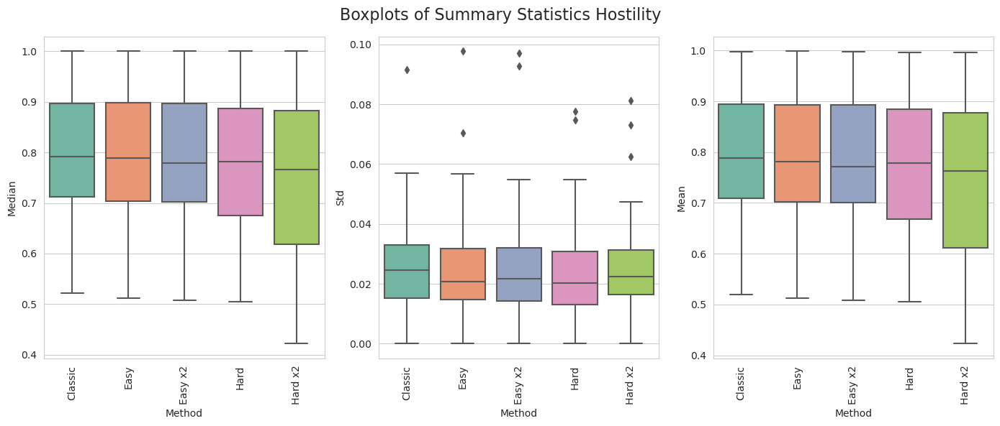

In [32]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with kDN

In [33]:
CM = 'kDN'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_kDN.csv')

,dataset,classic_test_acc_mean_median,sample_weight_easy_test_acc_mean_median,sample_weight_easy_x2_test_acc_mean_median,sample_weight_hard_test_acc_mean_median,sample_weight_hard_x2_test_acc_mean_median,classic_test_acc_mean_std,sample_weight_easy_test_acc_mean_std,sample_weight_easy_x2_test_acc_mean_std,sample_weight_hard_test_acc_mean_std,sample_weight_hard_x2_test_acc_mean_std,classic_test_acc_mean_total_mean,sample_weight_easy_test_acc_mean_total_mean,sample_weight_easy_x2_test_acc_mean_total_mean,sample_weight_hard_test_acc_mean_total_mean,sample_weight_hard_x2_test_acc_mean_total_mean
0,WineQualityRed_5vs6,0.714920,0.716441,0.719480,0.702030,0.667927,0.010983,0.011537,0.012599,0.016361,0.020202,0.710514,0.713067,0.714437,0.698268,0.662906
1,Yeast_CYTvsNUC,0.672634,0.662597,0.659819,0.642441,0.551586,0.011154,0.012619,0.012876,0.027299,0.020953,0.670679,0.659382,0.657441,0.633752,0.546685
2,arrhythmia_cfs,0.838599,0.778889,0.772222,0.814348,0.758889,0.037218,0.056893,0.061179,0.094214,0.109045,0.825952,0.762043,0.750736,0.772237,0.715767
3,bands,0.701351,0.676502,0.662950,0.679655,0.663288,0.023302,0.019755,0.016175,0.014848,0.039574,0.697034,0.673321,0.664174,0.675297,0.646182
4,banknote_authentication,0.975209,0.975939,0.975939,0.976671,0.976669,0.040893,0.040558,0.040561,0.040872,0.040759,0.962313,0.961505,0.961507,0.962722,0.962912
5,bodyfat,0.996000,0.996000,0.996000,0.996000,0.996000,0.000000,0.000000,0.000000,0.000000,0.000000,0.996000,0.996000,0.996000,0.996000,0.996000
6,breast-w,0.959938,0.959938,0.962795,0.962795,0.962795,0.030642,0.033858,0.034025,0.028112,0.024820,0.955661,0.955297,0.955648,0.958574,0.959480
7,breastcancer,1.000000,1.000000,1.000000,1.000000,1.000000,0.030345,0.030345,0.030345,0.030345,0.030345,0.997516,0.997516,0.997516,0.997516,0.997516
8,bupa,0.739118,0.720462,0.704202,0.730252,0.727563,0.032876,0.048634,0.042532,0.026038,0.033528,0.727420,0.704559,0.685116,0.719455,0.716386
9,chatfield_4,0.889130,0.885507,0.889493,0.867754,0.863768,0.024714,0.027179,0.030496,0.015910,0.007512,0.885731,0.885132,0.886407,0.869088,0.868121


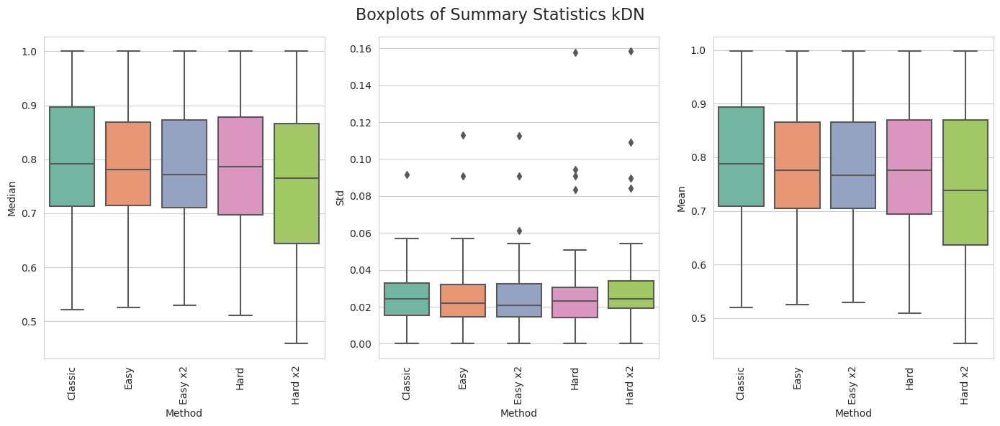

In [34]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with N1

In [35]:
CM = 'N1'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_N1.csv')

,dataset,classic_test_acc_mean_median,sample_weight_easy_test_acc_mean_median,sample_weight_easy_x2_test_acc_mean_median,sample_weight_hard_test_acc_mean_median,sample_weight_hard_x2_test_acc_mean_median,classic_test_acc_mean_std,sample_weight_easy_test_acc_mean_std,sample_weight_easy_x2_test_acc_mean_std,sample_weight_hard_test_acc_mean_std,sample_weight_hard_x2_test_acc_mean_std,classic_test_acc_mean_total_mean,sample_weight_easy_test_acc_mean_total_mean,sample_weight_easy_x2_test_acc_mean_total_mean,sample_weight_hard_test_acc_mean_total_mean,sample_weight_hard_x2_test_acc_mean_total_mean
0,WineQualityRed_5vs6,0.714920,0.711896,0.712659,0.708096,0.694448,0.010983,0.009504,0.010083,0.012157,0.017939,0.710514,0.708435,0.708859,0.706638,0.689445
1,Yeast_CYTvsNUC,0.672634,0.662497,0.661348,0.663770,0.633458,0.011154,0.009172,0.009403,0.006051,0.011209,0.670679,0.662845,0.661445,0.663188,0.636123
2,arrhythmia_cfs,0.838599,0.805507,0.794444,0.847633,0.843188,0.037218,0.047075,0.042542,0.037204,0.054708,0.825952,0.791314,0.781880,0.834402,0.824878
3,bands,0.701351,0.690165,0.690165,0.690315,0.687688,0.023302,0.023252,0.020298,0.014791,0.019362,0.697034,0.690244,0.685922,0.688374,0.679676
4,banknote_authentication,0.975209,0.975939,0.975939,0.975577,0.975939,0.040893,0.040935,0.040933,0.040921,0.040771,0.962313,0.962367,0.962376,0.962137,0.961912
5,bodyfat,0.996000,0.996000,0.996000,0.996000,0.996000,0.000000,0.000000,0.000000,0.000000,0.000000,0.996000,0.996000,0.996000,0.996000,0.996000
6,breast-w,0.959938,0.959938,0.961346,0.961366,0.961366,0.030642,0.029068,0.028997,0.030889,0.029664,0.955661,0.957434,0.957298,0.956337,0.956795
7,breastcancer,1.000000,1.000000,1.000000,1.000000,1.000000,0.030345,0.030345,0.030345,0.030345,0.030345,0.997516,0.997516,0.997516,0.997516,0.997516
8,bupa,0.739118,0.736471,0.733445,0.713193,0.690084,0.032876,0.042302,0.041665,0.023262,0.025875,0.727420,0.720076,0.710506,0.704161,0.681026
9,chatfield_4,0.889130,0.889130,0.889130,0.876449,0.872283,0.024714,0.025286,0.025049,0.020253,0.016063,0.885731,0.887686,0.887330,0.875216,0.873233


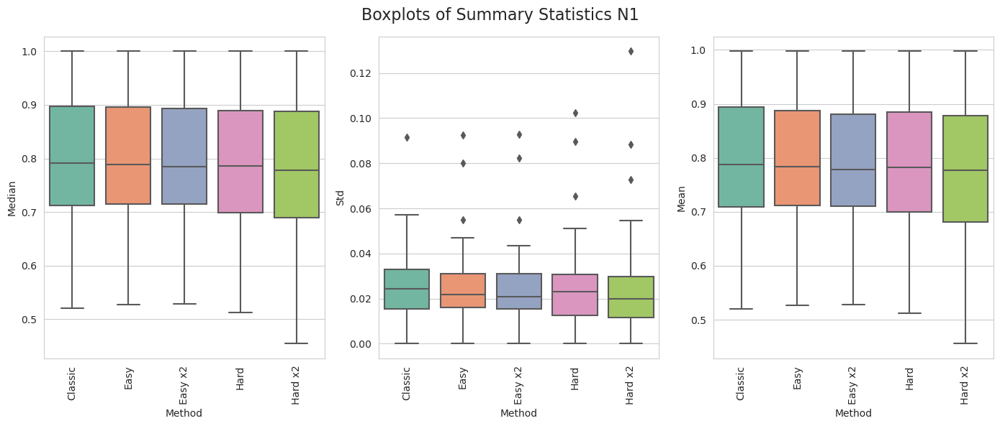

In [36]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with N2

In [37]:
CM = 'N2'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_N2.csv')

,dataset,classic_test_acc_mean_median,sample_weight_easy_test_acc_mean_median,sample_weight_easy_x2_test_acc_mean_median,sample_weight_hard_test_acc_mean_median,sample_weight_hard_x2_test_acc_mean_median,classic_test_acc_mean_std,sample_weight_easy_test_acc_mean_std,sample_weight_easy_x2_test_acc_mean_std,sample_weight_hard_test_acc_mean_std,sample_weight_hard_x2_test_acc_mean_std,classic_test_acc_mean_total_mean,sample_weight_easy_test_acc_mean_total_mean,sample_weight_easy_x2_test_acc_mean_total_mean,sample_weight_hard_test_acc_mean_total_mean,sample_weight_hard_x2_test_acc_mean_total_mean
0,WineQualityRed_5vs6,0.714920,0.705806,0.704285,0.719477,0.713393,0.010983,0.011052,0.011544,0.010461,0.008330,0.710514,0.702494,0.700712,0.716269,0.711643
1,Yeast_CYTvsNUC,0.672634,0.659189,0.659757,0.661448,0.653602,0.011154,0.011569,0.012871,0.012237,0.016946,0.670679,0.657411,0.657773,0.660436,0.650571
2,arrhythmia_cfs,0.838599,0.790000,0.781111,0.838792,0.829952,0.037218,0.046791,0.045472,0.061855,0.080674,0.825952,0.780215,0.768474,0.819385,0.799023
3,bands,0.701351,0.684535,0.678979,0.715390,0.693468,0.023302,0.020487,0.018836,0.023151,0.026016,0.697034,0.677543,0.668474,0.707047,0.689031
4,banknote_authentication,0.975209,0.960663,0.954462,0.968634,0.970099,0.040893,0.038368,0.036859,0.040924,0.041681,0.962313,0.947756,0.943271,0.953176,0.952608
5,bodyfat,0.996000,0.996000,0.996000,0.996000,0.996000,0.000000,0.000000,0.000000,0.000000,0.002123,0.996000,0.996000,0.996000,0.996000,0.995913
6,breast-w,0.959938,0.959917,0.958489,0.962795,0.962795,0.030642,0.043857,0.047058,0.005676,0.040887,0.955661,0.951002,0.948236,0.961156,0.958672
7,breastcancer,1.000000,1.000000,1.000000,1.000000,1.000000,0.030345,0.033899,0.033954,0.021542,0.020458,0.997516,0.996895,0.996772,0.998697,0.998819
8,bupa,0.739118,0.727647,0.710168,0.733529,0.716387,0.032876,0.039478,0.034866,0.030503,0.026557,0.727420,0.709831,0.695666,0.721068,0.707089
9,chatfield_4,0.889130,0.880616,0.884783,0.880616,0.876268,0.024714,0.031401,0.033388,0.005998,0.005075,0.885731,0.876968,0.880433,0.881289,0.878220


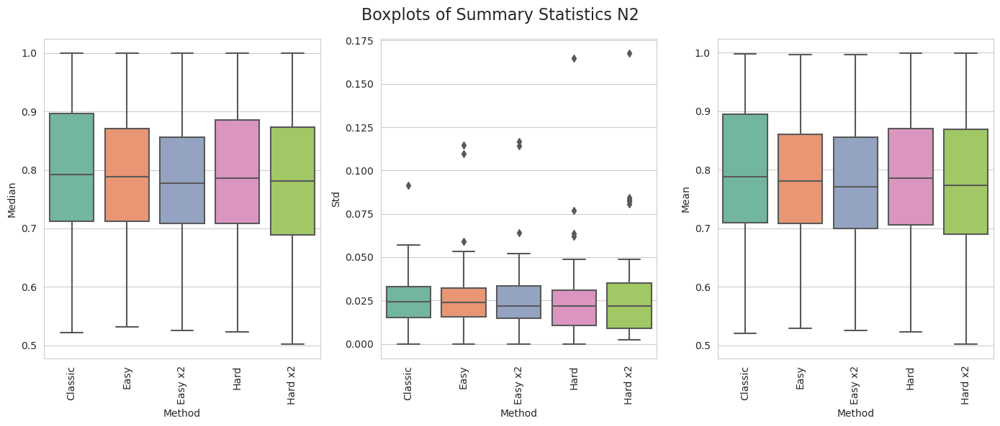

In [38]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with DCP

In [39]:
CM = 'DCP'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_DCP.csv')

,dataset,classic_test_acc_mean_median,sample_weight_easy_test_acc_mean_median,sample_weight_easy_x2_test_acc_mean_median,sample_weight_hard_test_acc_mean_median,sample_weight_hard_x2_test_acc_mean_median,classic_test_acc_mean_std,sample_weight_easy_test_acc_mean_std,sample_weight_easy_x2_test_acc_mean_std,sample_weight_hard_test_acc_mean_std,sample_weight_hard_x2_test_acc_mean_std,classic_test_acc_mean_total_mean,sample_weight_easy_test_acc_mean_total_mean,sample_weight_easy_x2_test_acc_mean_total_mean,sample_weight_hard_test_acc_mean_total_mean,sample_weight_hard_x2_test_acc_mean_total_mean
0,WineQualityRed_5vs6,0.714920,0.674717,0.668656,0.580381,0.511017,0.010983,0.011997,0.014468,0.023877,0.012304,0.710514,0.672540,0.668385,0.579169,0.508549
1,Yeast_CYTvsNUC,0.672634,0.650200,0.645718,0.531411,0.467016,0.011154,0.010135,0.009261,0.008377,0.012286,0.670679,0.649687,0.645390,0.531474,0.464965
2,arrhythmia_cfs,0.838599,0.820918,0.807633,0.787923,0.774686,0.037218,0.051256,0.056986,0.036865,0.053528,0.825952,0.802029,0.787226,0.772747,0.753968
3,bands,0.701351,0.671096,0.662838,0.577965,0.539565,0.023302,0.015385,0.011489,0.047005,0.042202,0.697034,0.665358,0.655386,0.570431,0.522997
4,banknote_authentication,0.975209,0.963533,0.961361,0.971554,0.962070,0.040893,0.052463,0.058626,0.041410,0.044041,0.962313,0.946079,0.942435,0.953415,0.947308
5,bodyfat,0.996000,0.996000,0.996000,0.996000,0.996000,0.000000,0.000000,0.000000,0.000000,0.000000,0.996000,0.996000,0.996000,0.996000,0.996000
6,breast-w,0.959938,0.954203,0.951346,0.958509,0.958509,0.030642,0.042932,0.046772,0.007155,0.041837,0.955661,0.944755,0.941074,0.957075,0.953155
7,breastcancer,1.000000,1.000000,1.000000,1.000000,1.000000,0.030345,0.030345,0.030345,0.030345,0.030345,0.997516,0.997516,0.997516,0.997516,0.997516
8,bupa,0.739118,0.704454,0.687227,0.689832,0.646387,0.032876,0.021452,0.019009,0.031726,0.027218,0.727420,0.698228,0.683152,0.676162,0.635871
9,chatfield_4,0.889130,0.885145,0.885145,0.880435,0.859239,0.024714,0.034132,0.038169,0.032597,0.043923,0.885731,0.879462,0.877678,0.878357,0.851800


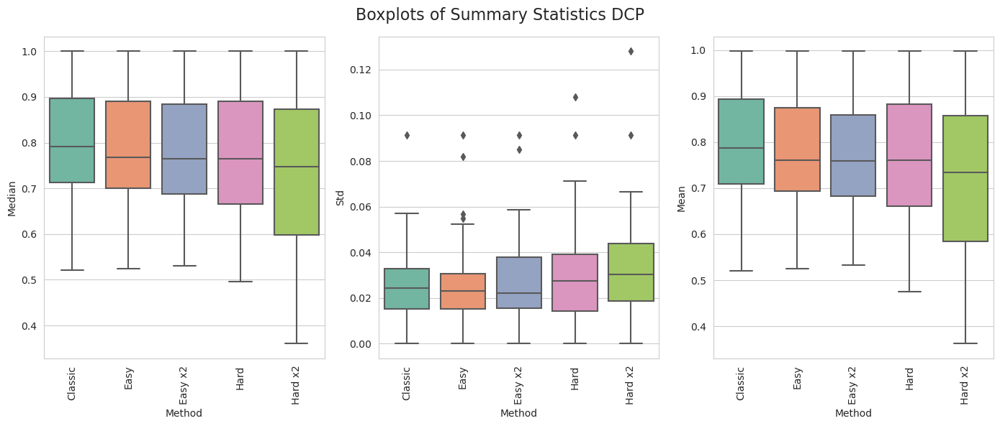

In [40]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with LSC

In [41]:
CM = 'LSC'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_LSC.csv')

,dataset,classic_test_acc_mean_median,sample_weight_easy_test_acc_mean_median,sample_weight_easy_x2_test_acc_mean_median,sample_weight_hard_test_acc_mean_median,sample_weight_hard_x2_test_acc_mean_median,classic_test_acc_mean_std,sample_weight_easy_test_acc_mean_std,sample_weight_easy_x2_test_acc_mean_std,sample_weight_hard_test_acc_mean_std,sample_weight_hard_x2_test_acc_mean_std,classic_test_acc_mean_total_mean,sample_weight_easy_test_acc_mean_total_mean,sample_weight_easy_x2_test_acc_mean_total_mean,sample_weight_hard_test_acc_mean_total_mean,sample_weight_hard_x2_test_acc_mean_total_mean
0,WineQualityRed_5vs6,0.714920,0.710381,0.708860,0.722519,0.707321,0.010983,0.009008,0.008597,0.024032,0.025986,0.710514,0.708546,0.707433,0.715392,0.698096
1,Yeast_CYTvsNUC,0.672634,0.660312,0.659164,0.668190,0.655843,0.011154,0.007419,0.007707,0.007336,0.006318,0.670679,0.659375,0.658971,0.666460,0.654648
2,arrhythmia_cfs,0.838599,0.807729,0.794493,0.838744,0.825386,0.037218,0.055145,0.058217,0.071773,0.083155,0.825952,0.784550,0.772332,0.809328,0.788319
3,bands,0.701351,0.690015,0.676426,0.698724,0.684985,0.023302,0.018007,0.014817,0.018513,0.015126,0.697034,0.682014,0.673707,0.692860,0.679655
4,banknote_authentication,0.975209,0.944610,0.940236,0.983222,0.988332,0.040893,0.045875,0.045734,0.026464,0.026178,0.962313,0.931531,0.922011,0.975839,0.979680
5,bodyfat,0.996000,0.996000,0.996000,0.996000,0.996000,0.000000,0.000000,0.006042,0.004598,0.008977,0.996000,0.996000,0.995753,0.995747,0.995507
6,breast-w,0.959938,0.954203,0.952774,0.962795,0.961366,0.030642,0.043270,0.046866,0.007348,0.038176,0.955661,0.947281,0.943626,0.961280,0.958153
7,breastcancer,1.000000,1.000000,1.000000,1.000000,1.000000,0.030345,0.032669,0.031671,0.023357,0.021493,0.997516,0.997018,0.997142,0.998383,0.998758
8,bupa,0.739118,0.736134,0.724790,0.716218,0.719160,0.032876,0.037770,0.035381,0.024239,0.026264,0.727420,0.721672,0.714184,0.708494,0.711337
9,chatfield_4,0.889130,0.889130,0.893478,0.876268,0.876268,0.024714,0.031644,0.033690,0.005195,0.004861,0.885731,0.887710,0.890214,0.878759,0.876690


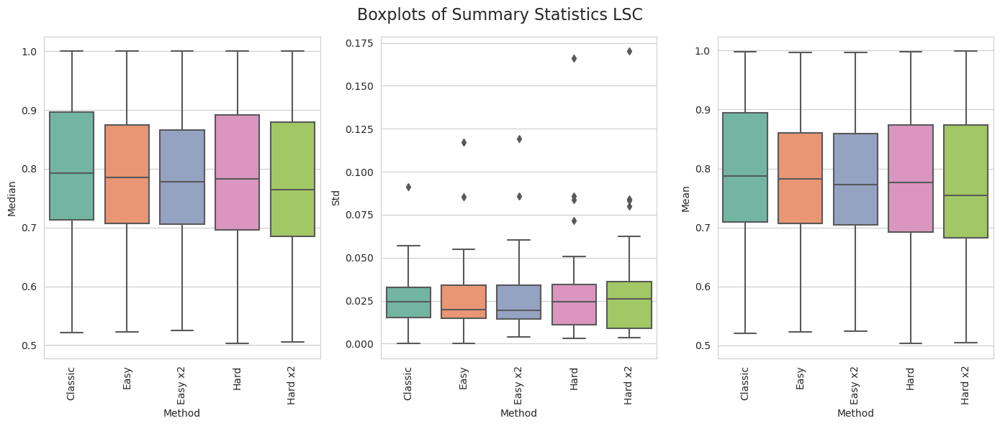

In [42]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with F1

In [43]:
CM = 'F1'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_F1.csv')

,dataset,classic_test_acc_mean_median,sample_weight_easy_test_acc_mean_median,sample_weight_easy_x2_test_acc_mean_median,sample_weight_hard_test_acc_mean_median,sample_weight_hard_x2_test_acc_mean_median,classic_test_acc_mean_std,sample_weight_easy_test_acc_mean_std,sample_weight_easy_x2_test_acc_mean_std,sample_weight_hard_test_acc_mean_std,sample_weight_hard_x2_test_acc_mean_std,classic_test_acc_mean_total_mean,sample_weight_easy_test_acc_mean_total_mean,sample_weight_easy_x2_test_acc_mean_total_mean,sample_weight_hard_test_acc_mean_total_mean,sample_weight_hard_x2_test_acc_mean_total_mean
0,WineQualityRed_5vs6,0.714920,0.709623,0.714157,0.712630,0.711867,0.010983,0.011722,0.010697,0.012978,0.013904,0.710514,0.708543,0.712235,0.708887,0.708935
1,Yeast_CYTvsNUC,0.672634,0.669213,0.668090,0.658015,0.658015,0.011154,0.012043,0.012212,0.005662,0.005682,0.670679,0.667175,0.667020,0.657030,0.657087
2,arrhythmia_cfs,0.838599,0.820870,0.805411,0.823116,0.820918,0.037218,0.050212,0.061222,0.060172,0.063914,0.825952,0.805747,0.790653,0.796337,0.789823
3,bands,0.701351,0.668393,0.665465,0.720721,0.715165,0.023302,0.009302,0.009202,0.033265,0.032624,0.697034,0.667037,0.664030,0.708458,0.701328
4,banknote_authentication,0.975209,0.965022,0.956284,0.981768,0.980316,0.040893,0.049842,0.050971,0.032719,0.039953,0.962313,0.952996,0.947393,0.968103,0.968597
5,bodyfat,0.996000,0.996000,0.996000,0.996000,0.996000,0.000000,0.004598,0.020133,0.016112,0.024038,0.996000,0.995747,0.994917,0.995103,0.994613
6,breast-w,0.959938,0.955631,0.954203,0.961366,0.962795,0.030642,0.041355,0.043140,0.005149,0.033220,0.955661,0.947978,0.944755,0.961061,0.959023
7,breastcancer,1.000000,1.000000,1.000000,1.000000,1.000000,0.030345,0.021547,0.019267,0.033960,0.034478,0.997516,0.998694,0.998887,0.996766,0.996521
8,bupa,0.739118,0.721597,0.701176,0.719076,0.713319,0.032876,0.033063,0.029743,0.032663,0.030660,0.727420,0.714004,0.699862,0.707569,0.702651
9,chatfield_4,0.889130,0.875906,0.875906,0.880616,0.880616,0.024714,0.026259,0.025492,0.020196,0.017327,0.885731,0.875548,0.874963,0.881155,0.879418


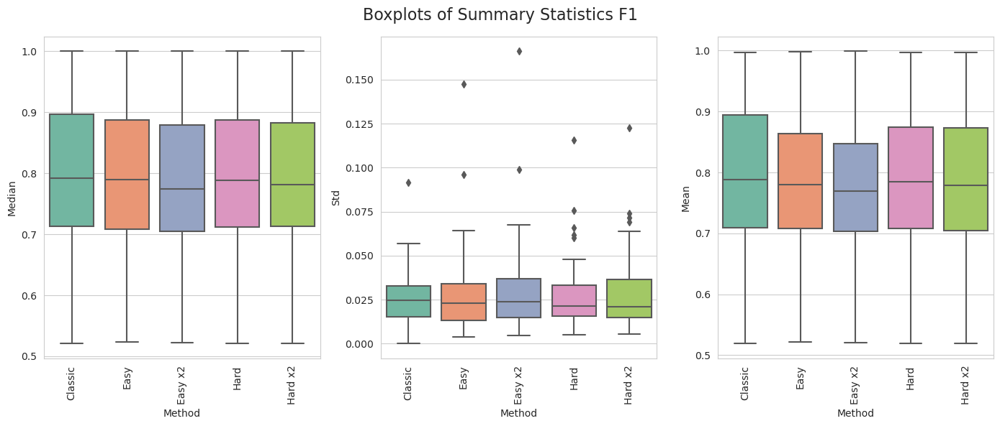

In [44]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with TD_U

In [45]:
CM = 'TD_U'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_TDU.csv')

,dataset,classic_test_acc_mean_median,sample_weight_easy_test_acc_mean_median,sample_weight_easy_x2_test_acc_mean_median,sample_weight_hard_test_acc_mean_median,sample_weight_hard_x2_test_acc_mean_median,classic_test_acc_mean_std,sample_weight_easy_test_acc_mean_std,sample_weight_easy_x2_test_acc_mean_std,sample_weight_hard_test_acc_mean_std,sample_weight_hard_x2_test_acc_mean_std,classic_test_acc_mean_total_mean,sample_weight_easy_test_acc_mean_total_mean,sample_weight_easy_x2_test_acc_mean_total_mean,sample_weight_hard_test_acc_mean_total_mean,sample_weight_hard_x2_test_acc_mean_total_mean
0,WineQualityRed_5vs6,0.714920,0.724023,0.715655,0.705063,0.704308,0.010983,0.020921,0.021597,0.013729,0.016723,0.710514,0.716453,0.708134,0.702933,0.699951
1,Yeast_CYTvsNUC,0.672634,0.665918,0.662534,0.645780,0.636804,0.011154,0.008144,0.009885,0.010906,0.011394,0.670679,0.663587,0.659744,0.644721,0.635084
2,arrhythmia_cfs,0.838599,0.798889,0.745942,0.823237,0.803382,0.037218,0.103335,0.112958,0.074301,0.076705,0.825952,0.755013,0.695993,0.781528,0.764101
3,bands,0.701351,0.673536,0.668131,0.704279,0.682282,0.023302,0.022847,0.024166,0.028227,0.023237,0.697034,0.662317,0.657391,0.691105,0.674038
4,banknote_authentication,0.975209,0.954454,0.938051,0.956985,0.951878,0.040893,0.053437,0.057676,0.043573,0.045330,0.962313,0.941170,0.927509,0.938461,0.933706
5,bodyfat,0.996000,0.996000,0.996000,0.996000,0.996000,0.000000,0.000000,0.000000,0.000000,0.000000,0.996000,0.996000,0.996000,0.996000,0.996000
6,breast-w,0.959938,0.962816,0.961408,0.951346,0.952774,0.030642,0.036492,0.042588,0.018416,0.037154,0.955661,0.955451,0.952620,0.947055,0.945936
7,breastcancer,1.000000,1.000000,1.000000,1.000000,1.000000,0.030345,0.030345,0.030345,0.030345,0.030345,0.997516,0.997516,0.997516,0.997516,0.997516
8,bupa,0.739118,0.713193,0.695630,0.715882,0.704370,0.032876,0.028516,0.029953,0.045535,0.042962,0.727420,0.705179,0.683134,0.691723,0.681756
9,chatfield_4,0.889130,0.884783,0.888768,0.872283,0.872283,0.024714,0.032522,0.033972,0.028811,0.038975,0.885731,0.878758,0.880319,0.871225,0.867117


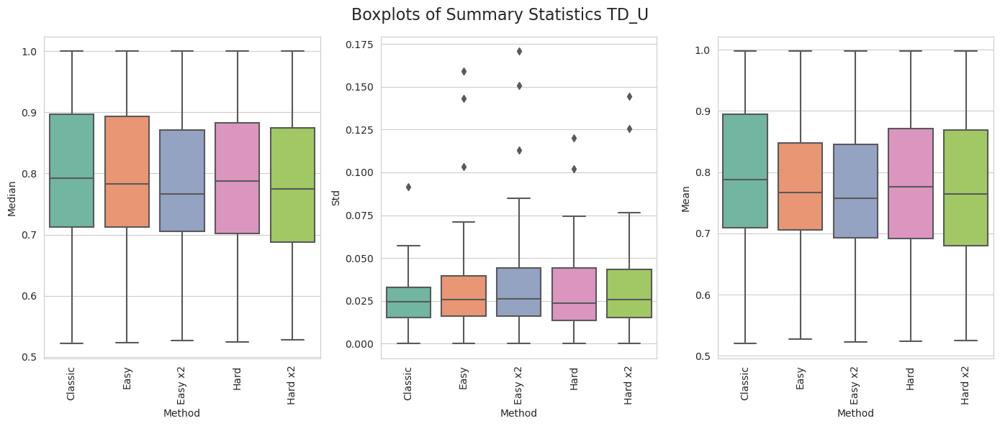

In [46]:
plot_summary_CM(CM,summary_table_CM)

#### Summary table with CLD

In [47]:
CM = 'CLD'
summary_table_CM = summary_CM(CM,all_datasets)
summary_table_CM
#summary_table_CM.to_csv('SummaryStatistics_PerDataset_Boosting_CLD.csv')

,dataset,classic_test_acc_mean_median,sample_weight_easy_test_acc_mean_median,sample_weight_easy_x2_test_acc_mean_median,sample_weight_hard_test_acc_mean_median,sample_weight_hard_x2_test_acc_mean_median,classic_test_acc_mean_std,sample_weight_easy_test_acc_mean_std,sample_weight_easy_x2_test_acc_mean_std,sample_weight_hard_test_acc_mean_std,sample_weight_hard_x2_test_acc_mean_std,classic_test_acc_mean_total_mean,sample_weight_easy_test_acc_mean_total_mean,sample_weight_easy_x2_test_acc_mean_total_mean,sample_weight_hard_test_acc_mean_total_mean,sample_weight_hard_x2_test_acc_mean_total_mean
0,WineQualityRed_5vs6,0.714920,0.708114,0.703545,0.589839,0.488226,0.010983,0.013931,0.014156,0.008427,0.012026,0.710514,0.703742,0.700248,0.588325,0.488281
1,Yeast_CYTvsNUC,0.672634,0.600874,0.582928,0.513458,0.504494,0.011154,0.018135,0.015159,0.007480,0.004564,0.670679,0.597208,0.580127,0.513321,0.504802
2,arrhythmia_cfs,0.838599,0.823188,0.812126,0.770242,0.734734,0.037218,0.040888,0.057579,0.050208,0.038467,0.825952,0.808189,0.794208,0.752035,0.721812
3,bands,0.701351,0.654655,0.651877,0.580781,0.547898,0.023302,0.010447,0.012338,0.034038,0.034848,0.697034,0.651498,0.649276,0.570917,0.535673
4,banknote_authentication,0.975209,0.930776,0.917666,0.985423,0.946781,0.040893,0.039543,0.037563,0.034028,0.066010,0.962313,0.918077,0.905090,0.972773,0.927017
5,bodyfat,0.996000,0.996000,0.996000,0.996000,0.996000,0.000000,0.039745,0.048562,0.036112,0.040107,0.996000,0.992747,0.990793,0.993223,0.992720
6,breast-w,0.959938,0.954182,0.954182,0.962795,0.961366,0.030642,0.045066,0.051556,0.029354,0.051839,0.955661,0.945348,0.941763,0.959339,0.956342
7,breastcancer,1.000000,1.000000,1.000000,1.000000,1.000000,0.030345,0.054291,0.060077,0.044291,0.067428,0.997516,0.991927,0.990064,0.996863,0.992680
8,bupa,0.739118,0.643697,0.626218,0.568067,0.498487,0.032876,0.032343,0.026774,0.056644,0.038506,0.727420,0.636539,0.622126,0.557110,0.493016
9,chatfield_4,0.889130,0.872464,0.872464,0.876449,0.872283,0.024714,0.036973,0.039933,0.034476,0.046907,0.885731,0.867505,0.865644,0.876301,0.869487


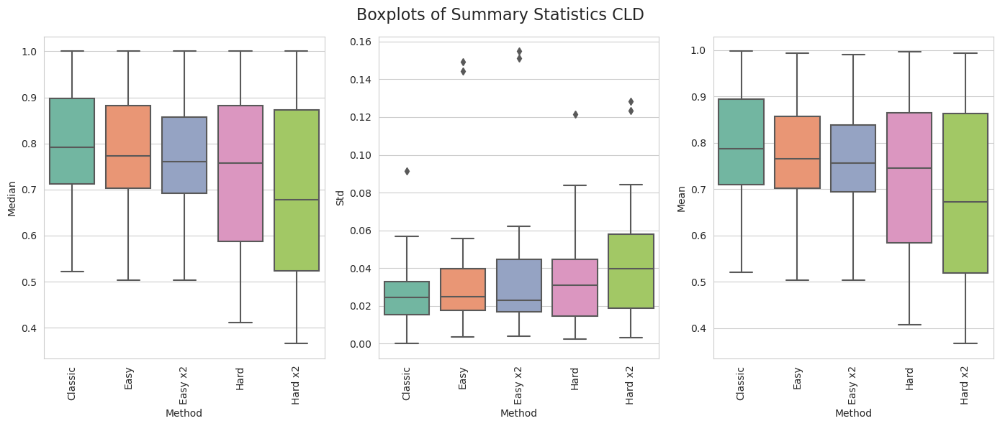

In [48]:
plot_summary_CM(CM,summary_table_CM)

In [49]:
all_datasets.head()

,dataset,n_ensemble,method_weights,compl_measure,loss_selected,loss_train_mean,loss_test_mean,train_acc_mean,test_acc_mean,loss_train_std,loss_test_std,train_acc_std,test_acc_std,conf_matr_train_total,conf_matr_test_total
0,diabetic_retinopathy,1,classic,none,log_loss,0.683345,0.685270,0.530843,0.530840,0.000490,0.002844,0.000143,0.001280,"[[0, 4860], [0, 5499]]","[[0, 540], [0, 611]]"
1,diabetic_retinopathy,2,classic,none,log_loss,0.676625,0.678590,0.530843,0.530840,0.000946,0.004602,0.000143,0.001280,"[[0, 4860], [0, 5499]]","[[0, 540], [0, 611]]"
2,diabetic_retinopathy,3,classic,none,log_loss,0.670412,0.673566,0.530843,0.530840,0.001203,0.006777,0.000143,0.001280,"[[0, 4860], [0, 5499]]","[[0, 540], [0, 611]]"
3,diabetic_retinopathy,4,classic,none,log_loss,0.665064,0.668974,0.530843,0.530840,0.001577,0.007955,0.000143,0.001280,"[[0, 4860], [0, 5499]]","[[0, 540], [0, 611]]"
4,diabetic_retinopathy,5,classic,none,log_loss,0.660049,0.664527,0.605951,0.583786,0.001779,0.010178,0.064662,0.052326,"[[2380, 2480], [1602, 3897]]","[[250, 290], [189, 422]]"


#### Graph analysis per complexity measure and per dataset

In [50]:
def plot_per_CM_dataset(CM,dataset):
    # Grid dimensiones
    num_datasets = dataset['dataset'].nunique()
    num_cols = 4  # Ajusta esto según el diseño que prefieras
    num_rows = math.ceil(num_datasets / num_cols)

    # Configura el tamaño de la figura
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 4, num_rows * 4), sharex=True, sharey=False)
    fig.suptitle('Test acc across Datasets for: '+CM, fontsize=18)

    all_datasets_CM = dataset.loc[(dataset['compl_measure'] == CM) | (dataset['compl_measure'] == 'none'),:]

    # Itera sobre cada dataset y subtrama correspondiente
    for i, (name_dataset, data) in enumerate(all_datasets_CM.groupby('dataset')):
        row = i // num_cols
        col = i % num_cols
        ax = axes[row, col]  # Selecciona el subplot correspondiente

        # Crear el gráfico de líneas para el dataset actual
        sns.lineplot(data=data, x='n_ensemble', y='test_acc_mean', hue='method_weights',
                     #marker='.',
                     palette=colour_palette_personalized, ax=ax, legend=False)

        # Configuración de cada subplot
        ax.set_title(f'{name_dataset}')
        #ax.set_xlabel('n_ensemble')
        #ax.set_ylabel('misc_rate_test_mean')
        ax.set_xticks(range(1, 301, 50))
        ax.grid(True)

    # Agrega una leyenda global fuera de la cuadrícula de gráficos
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, title='Method', loc='upper center', bbox_to_anchor=(0.5, -0.05), ncol=5, fontsize=12)
    # 
    # # add legend
    # handles, labels = ax.get_legend_handles_labels()
    # fig.legend(handles, labels, loc='upper right', ncol=3, bbox_to_anchor=(0.8, 1), frameon=False)


    # Ajusta el diseño para que no se superpongan las gráficas y la leyenda global
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])  # Ajusta para dejar espacio para el título y la leyenda
    plt.show()
    return

In [51]:
# Reordenamos para que al pintar siempre se pinte el último el métod classic y facilite la comparación
all_datasets_reordenada = pd.concat([
    all_datasets[all_datasets['method_weights'] != 'classic'],  
    all_datasets[all_datasets['method_weights'] == 'classic']   
])

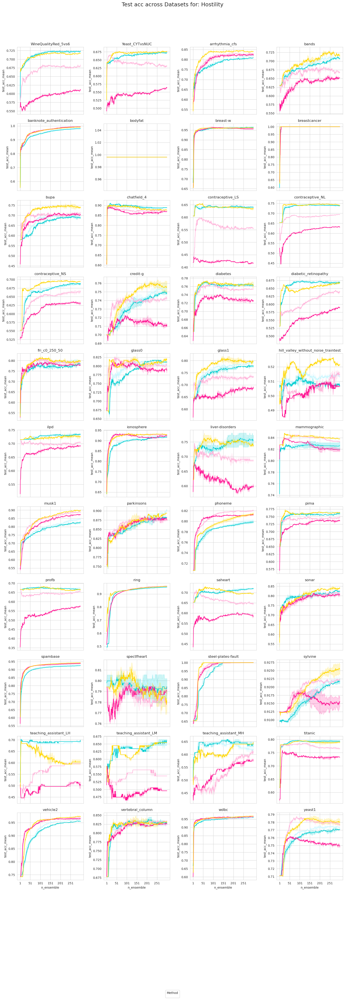

In [52]:
CM = 'Hostility'
plot_per_CM_dataset(CM,all_datasets_reordenada)

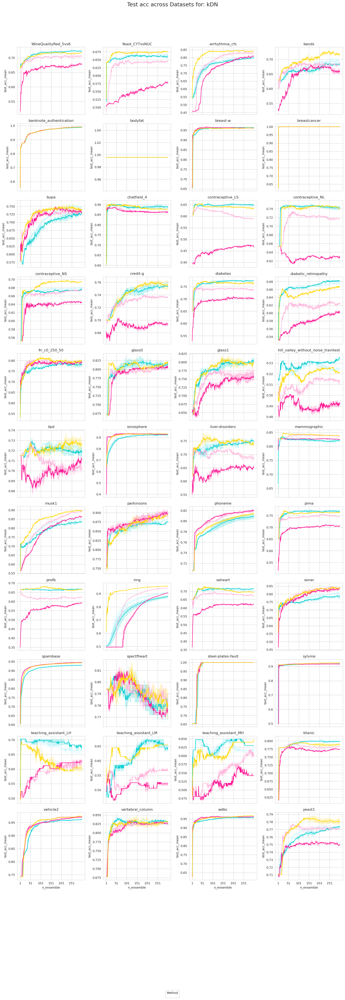

In [53]:
CM = 'kDN'
plot_per_CM_dataset(CM,all_datasets_reordenada)

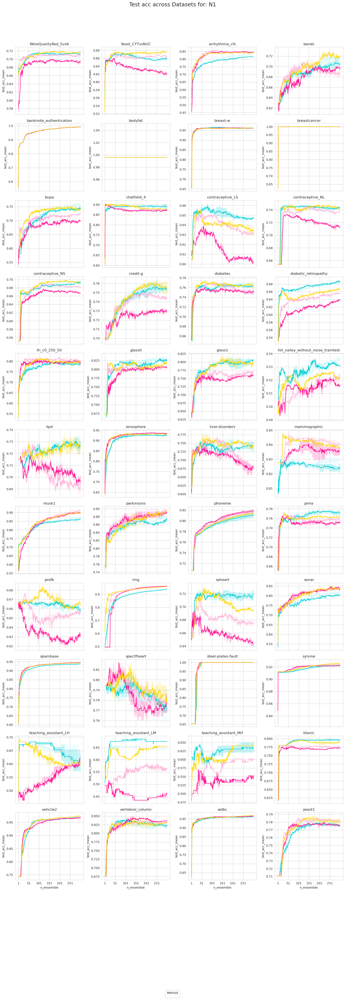

In [54]:
CM = 'N1'
plot_per_CM_dataset(CM,all_datasets_reordenada)

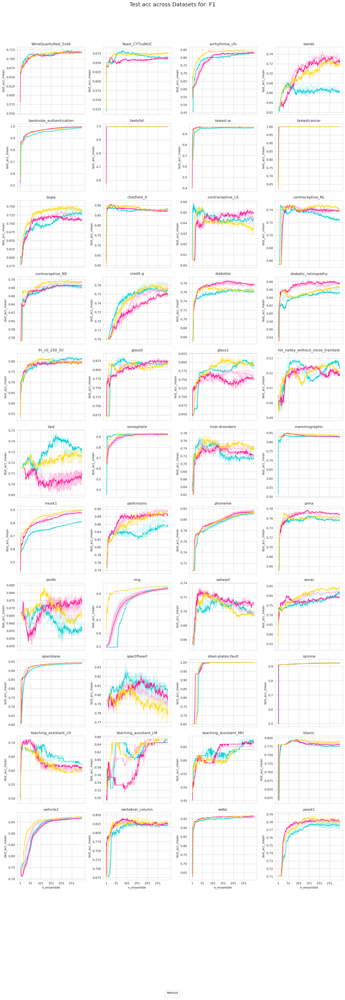

In [55]:
CM = 'F1'
plot_per_CM_dataset(CM,all_datasets_reordenada)

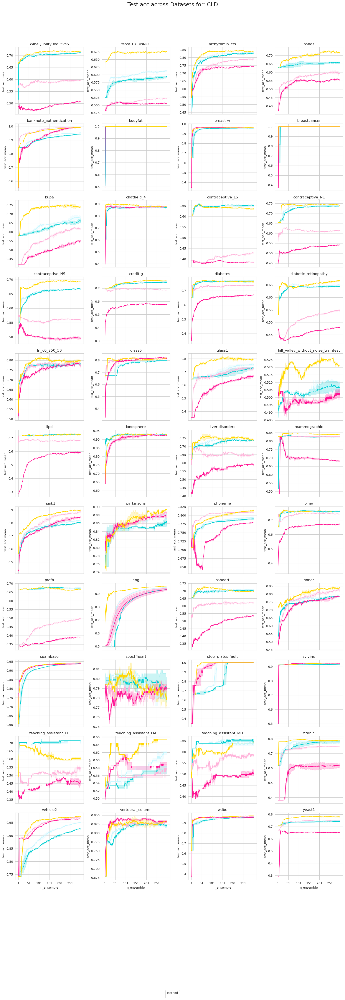

In [56]:
CM = 'CLD'
plot_per_CM_dataset(CM,all_datasets_reordenada)

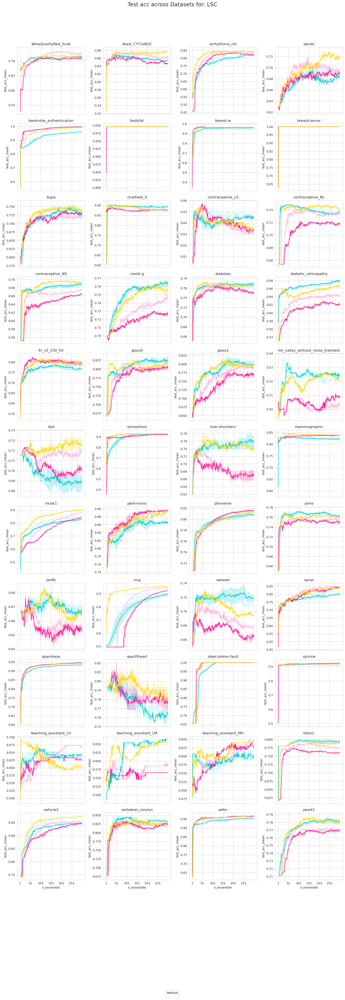

In [57]:
CM = 'LSC'
plot_per_CM_dataset(CM,all_datasets_reordenada)

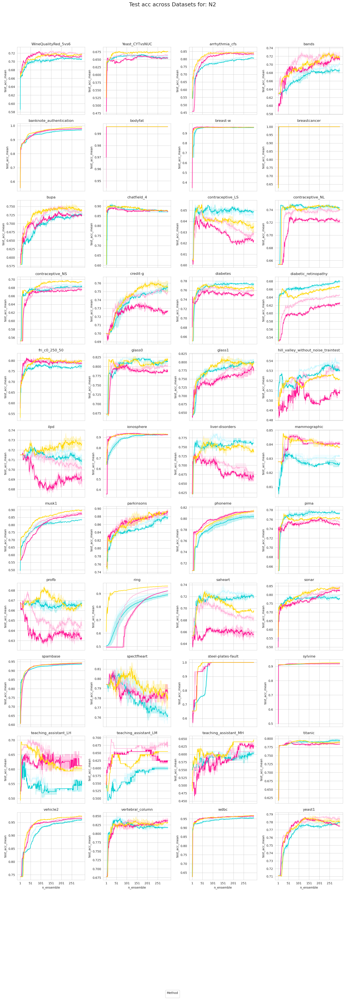

In [58]:
CM = 'N2'
plot_per_CM_dataset(CM,all_datasets_reordenada)

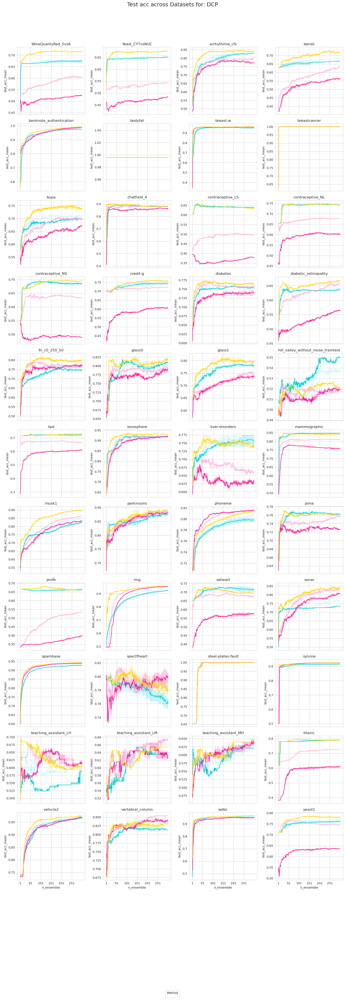

In [59]:
CM = 'DCP'
plot_per_CM_dataset(CM,all_datasets_reordenada)

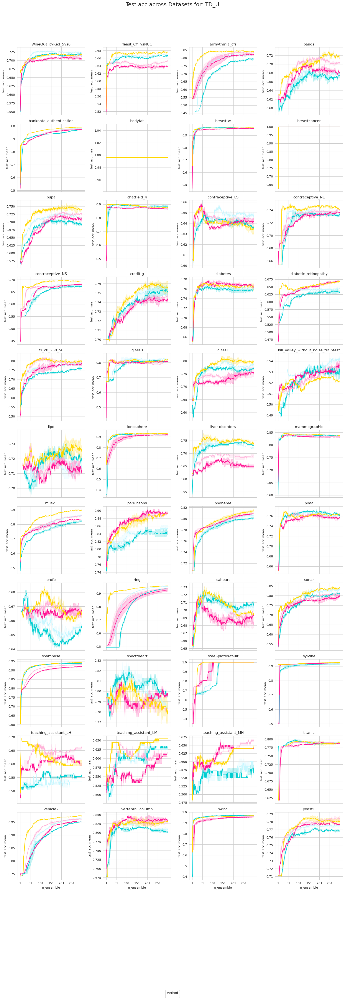

In [60]:
CM = 'TD_U'
plot_per_CM_dataset(CM,all_datasets_reordenada)

### WTL Analysis per complexity measure and method

In [27]:

def win_tie_loss_comparison(data, main_method, compare_method,loss_function,
                            metric='test_acc_mean',  n_ensemble_values=[10, 25, 50, 100, 150, 200, 250, 300]):
    """
    Realiza un análisis win-tie-loss comparando el método principal con otro método específico para cada medida de complejidad.

    Parameters:
    - data: DataFrame con las columnas ['dataset', 'n_ensemble', 'method_weights', 'compl_measure', metric]
    - main_method: método principal que se desea comparar (ejemplo: 'classic')
    - compare_method: método específico con el cual comparar el principal (ejemplo: 'init_easy')
    - metric: métrica de comparación (por defecto 'misc_rate_test_mean')
    - n_ensemble_values: valores de n_ensemble a considerar

    Returns:
    - Una tabla con el conteo de wins, ties, y losses por cada valor de n_ensemble y medida de complejidad.
    """
    results = []

    for n in n_ensemble_values:
        # Filtrar los datos para el valor actual de n_ensemble
        subset_n = data[(data['n_ensemble'] == n) & (data['loss_selected'] == loss_function)]


        # Crear un diccionario para almacenar los resultados de esta combinación de n_ensemble
        row = {'n_ensemble': n}

        CM_list = subset_n['compl_measure'].unique()[1:] # to delete none

        for compl in CM_list:
            win, tie, loss = 0, 0, 0

            # Filtrar los datos para la medida de complejidad actual
            subset_compl = subset_n[subset_n['compl_measure'] == compl]
            #if (main_method == 'classic') or (compare_method == 'classic'):
            #     subset_compl_main = subset_n[subset_n['compl_measure'] == 'none']

            for dataset in subset_compl['dataset'].unique():
                # Filtrar para el dataset y métod en cuestión

                if (main_method == 'classic'):
                    subset_compl_main = subset_n[subset_n['compl_measure'] == 'none']
                    main_value = subset_compl_main[(subset_compl_main['dataset'] == dataset) & (subset_compl_main['method_weights'] == main_method)][metric].values
                else:
                    main_value = subset_compl[(subset_compl['dataset'] == dataset) & (subset_compl['method_weights'] == main_method)][metric].values
                if (compare_method == 'classic'):
                    subset_compl_compare = subset_n[subset_n['compl_measure'] == 'none']
                    compare_value = subset_compl_compare[(subset_compl_compare['dataset'] == dataset) & (subset_compl_compare['method_weights'] == compare_method)][metric].values
                else:
                    compare_value = subset_compl[(subset_compl['dataset'] == dataset) & (subset_compl['method_weights'] == compare_method)][metric].values

                # Verificar que tenemos valores únicos para cada dataset y métod
                if main_value.size > 0 and compare_value.size > 0:
                    main_value = main_value[0]
                    compare_value = compare_value[0]

                    # Comparación win-tie-loss
                    if main_value < compare_value:
                        win += 1
                    elif main_value == compare_value:
                        tie += 1
                    else:
                        loss += 1

            # Guardar el resultado para esta medida de complejidad en una columna específica
            row[f'{compare_method}_{compl}'] = (win, tie, loss)

        # Agregar el resultado de esta iteración a los resultados
        results.append(row)

    # Convertir los resultados a DataFrame
    win_tie_loss_df = pd.DataFrame(results)
    return win_tie_loss_df




Here we're comparing classic method vs init_easy with all complexity measures. The results are in the form (W,T,L) from the point of view of classic. Thus, the higher the number of wins, the better for us, since a win is that the compare_method is higher than the main_method

In [29]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='sample_weight_easy', loss_function='log_loss')
# exponential
result_table

,n_ensemble,sample_weight_easy_Hostility,sample_weight_easy_kDN,sample_weight_easy_DCP,sample_weight_easy_TD_U,sample_weight_easy_CLD,sample_weight_easy_N1,sample_weight_easy_N2,sample_weight_easy_LSC,sample_weight_easy_F1
0,10,"(11, 9, 24)","(16, 10, 18)","(10, 11, 23)","(7, 11, 26)","(15, 8, 21)","(19, 9, 16)","(12, 10, 22)","(20, 7, 17)","(11, 15, 18)"
1,25,"(9, 6, 29)","(9, 3, 32)","(5, 5, 34)","(8, 3, 33)","(8, 2, 34)","(11, 4, 29)","(11, 5, 28)","(8, 4, 32)","(12, 3, 29)"
2,50,"(11, 2, 31)","(16, 3, 25)","(4, 3, 37)","(11, 2, 31)","(8, 2, 34)","(14, 3, 27)","(8, 2, 34)","(17, 2, 25)","(13, 4, 27)"
3,100,"(13, 2, 29)","(13, 4, 27)","(6, 4, 34)","(11, 4, 29)","(8, 2, 34)","(14, 3, 27)","(12, 3, 29)","(11, 4, 29)","(13, 4, 27)"
4,150,"(14, 3, 27)","(15, 4, 25)","(7, 3, 34)","(10, 4, 30)","(6, 3, 35)","(12, 5, 27)","(10, 3, 31)","(15, 3, 26)","(8, 3, 33)"
5,200,"(15, 3, 26)","(15, 4, 25)","(8, 3, 33)","(11, 3, 30)","(8, 3, 33)","(12, 5, 27)","(9, 3, 32)","(18, 3, 23)","(8, 5, 31)"
6,250,"(17, 3, 24)","(14, 4, 26)","(9, 5, 30)","(10, 4, 30)","(6, 4, 34)","(14, 4, 26)","(11, 5, 28)","(14, 3, 27)","(13, 5, 26)"
7,300,"(15, 4, 25)","(16, 5, 23)","(8, 4, 32)","(9, 5, 30)","(6, 3, 35)","(17, 3, 24)","(11, 4, 29)","(14, 3, 27)","(11, 5, 28)"


In [30]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='sample_weight_easy', loss_function='exponential')
#
result_table

,n_ensemble,sample_weight_easy_Hostility,sample_weight_easy_kDN,sample_weight_easy_DCP,sample_weight_easy_TD_U,sample_weight_easy_CLD,sample_weight_easy_N1,sample_weight_easy_N2,sample_weight_easy_LSC,sample_weight_easy_F1
0,10,"(8, 12, 24)","(10, 15, 19)","(7, 11, 26)","(9, 12, 23)","(8, 12, 24)","(13, 14, 17)","(8, 14, 22)","(14, 10, 20)","(10, 17, 17)"
1,25,"(10, 2, 32)","(12, 6, 26)","(5, 4, 35)","(5, 3, 36)","(6, 3, 35)","(13, 3, 28)","(9, 3, 32)","(13, 5, 26)","(13, 5, 26)"
2,50,"(8, 6, 30)","(15, 5, 24)","(5, 5, 34)","(12, 2, 30)","(6, 4, 34)","(14, 3, 27)","(12, 2, 30)","(14, 2, 28)","(13, 6, 25)"
3,100,"(10, 5, 29)","(14, 4, 26)","(5, 4, 35)","(10, 3, 31)","(10, 3, 31)","(15, 5, 24)","(13, 4, 27)","(14, 3, 27)","(11, 5, 28)"
4,150,"(11, 4, 29)","(15, 3, 26)","(5, 5, 34)","(12, 3, 29)","(8, 3, 33)","(15, 5, 24)","(9, 3, 32)","(14, 3, 27)","(11, 4, 29)"
5,200,"(13, 4, 27)","(14, 4, 26)","(8, 4, 32)","(10, 3, 31)","(8, 3, 33)","(18, 5, 21)","(12, 3, 29)","(15, 3, 26)","(13, 3, 28)"
6,250,"(14, 4, 26)","(13, 6, 25)","(9, 5, 30)","(10, 4, 30)","(6, 3, 35)","(20, 4, 20)","(11, 3, 30)","(14, 5, 25)","(14, 3, 27)"
7,300,"(14, 4, 26)","(15, 3, 26)","(13, 5, 26)","(11, 5, 28)","(9, 3, 32)","(18, 3, 23)","(13, 4, 27)","(14, 4, 26)","(14, 5, 25)"


In [31]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='sample_weight_easy_x2', loss_function='log_loss')
result_table

,n_ensemble,sample_weight_easy_x2_Hostility,sample_weight_easy_x2_kDN,sample_weight_easy_x2_DCP,sample_weight_easy_x2_TD_U,sample_weight_easy_x2_CLD,sample_weight_easy_x2_N1,sample_weight_easy_x2_N2,sample_weight_easy_x2_LSC,sample_weight_easy_x2_F1
0,10,"(13, 8, 23)","(14, 10, 20)","(14, 9, 21)","(7, 9, 28)","(15, 7, 22)","(17, 11, 16)","(13, 7, 24)","(19, 7, 18)","(12, 11, 21)"
1,25,"(8, 3, 33)","(9, 4, 31)","(5, 4, 35)","(6, 3, 35)","(4, 3, 37)","(12, 3, 29)","(10, 3, 31)","(9, 3, 32)","(9, 4, 31)"
2,50,"(10, 2, 32)","(14, 3, 27)","(4, 3, 37)","(6, 2, 36)","(6, 2, 36)","(17, 3, 24)","(10, 2, 32)","(14, 2, 28)","(14, 4, 26)"
3,100,"(10, 2, 32)","(14, 5, 25)","(7, 3, 34)","(7, 3, 34)","(6, 2, 36)","(14, 3, 27)","(8, 3, 33)","(12, 2, 30)","(12, 4, 28)"
4,150,"(11, 3, 30)","(16, 4, 24)","(9, 3, 32)","(9, 3, 32)","(5, 2, 37)","(17, 3, 24)","(9, 3, 32)","(13, 4, 27)","(8, 4, 32)"
5,200,"(14, 4, 26)","(14, 4, 26)","(7, 3, 34)","(8, 3, 33)","(8, 4, 32)","(15, 5, 24)","(10, 4, 30)","(16, 3, 25)","(8, 4, 32)"
6,250,"(15, 4, 25)","(16, 3, 25)","(6, 4, 34)","(9, 3, 32)","(8, 3, 33)","(14, 5, 25)","(10, 4, 30)","(14, 4, 26)","(12, 4, 28)"
7,300,"(13, 4, 27)","(17, 4, 23)","(6, 3, 35)","(5, 5, 34)","(8, 3, 33)","(12, 4, 28)","(9, 4, 31)","(14, 3, 27)","(11, 4, 29)"


In [32]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='sample_weight_easy_x2', loss_function='exponential')
result_table

,n_ensemble,sample_weight_easy_x2_Hostility,sample_weight_easy_x2_kDN,sample_weight_easy_x2_DCP,sample_weight_easy_x2_TD_U,sample_weight_easy_x2_CLD,sample_weight_easy_x2_N1,sample_weight_easy_x2_N2,sample_weight_easy_x2_LSC,sample_weight_easy_x2_F1
0,10,"(5, 12, 27)","(10, 12, 22)","(7, 10, 27)","(6, 11, 27)","(7, 12, 25)","(11, 15, 18)","(12, 11, 21)","(15, 9, 20)","(12, 11, 21)"
1,25,"(9, 2, 33)","(7, 4, 33)","(4, 4, 36)","(5, 3, 36)","(3, 2, 39)","(10, 3, 31)","(7, 3, 34)","(13, 4, 27)","(11, 3, 30)"
2,50,"(9, 2, 33)","(14, 4, 26)","(3, 4, 37)","(5, 2, 37)","(6, 3, 35)","(13, 5, 26)","(11, 3, 30)","(13, 3, 28)","(13, 5, 26)"
3,100,"(14, 3, 27)","(12, 3, 29)","(7, 3, 34)","(7, 3, 34)","(5, 2, 37)","(17, 3, 24)","(9, 5, 30)","(11, 2, 31)","(12, 4, 28)"
4,150,"(11, 4, 29)","(14, 3, 27)","(6, 3, 35)","(8, 3, 33)","(7, 2, 35)","(15, 5, 24)","(9, 3, 32)","(14, 5, 25)","(9, 3, 32)"
5,200,"(10, 3, 31)","(16, 3, 25)","(10, 3, 31)","(9, 3, 32)","(7, 3, 34)","(14, 4, 26)","(10, 3, 31)","(14, 4, 26)","(11, 3, 30)"
6,250,"(12, 3, 29)","(13, 4, 27)","(9, 3, 32)","(8, 4, 32)","(9, 4, 31)","(15, 3, 26)","(11, 4, 29)","(17, 4, 23)","(12, 3, 29)"
7,300,"(15, 3, 26)","(14, 5, 25)","(9, 3, 32)","(8, 4, 32)","(9, 3, 32)","(19, 3, 22)","(14, 3, 27)","(16, 5, 23)","(13, 4, 27)"


In [34]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='sample_weight_hard', loss_function='log_loss')
result_table

,n_ensemble,sample_weight_hard_Hostility,sample_weight_hard_kDN,sample_weight_hard_DCP,sample_weight_hard_TD_U,sample_weight_hard_CLD,sample_weight_hard_N1,sample_weight_hard_N2,sample_weight_hard_LSC,sample_weight_hard_F1
0,10,"(16, 5, 23)","(14, 10, 20)","(8, 4, 32)","(13, 6, 25)","(12, 4, 28)","(11, 16, 17)","(16, 9, 19)","(12, 10, 22)","(14, 10, 20)"
1,25,"(14, 2, 28)","(11, 2, 31)","(3, 4, 37)","(8, 3, 33)","(8, 2, 34)","(14, 4, 26)","(16, 3, 25)","(12, 2, 30)","(16, 3, 25)"
2,50,"(12, 4, 28)","(12, 3, 29)","(3, 4, 37)","(6, 3, 35)","(7, 2, 35)","(17, 3, 24)","(18, 4, 22)","(16, 3, 25)","(19, 5, 20)"
3,100,"(8, 3, 33)","(10, 4, 30)","(6, 3, 35)","(11, 3, 30)","(5, 3, 36)","(15, 3, 26)","(15, 4, 25)","(13, 4, 27)","(16, 7, 21)"
4,150,"(5, 5, 34)","(7, 4, 33)","(5, 4, 35)","(10, 4, 30)","(5, 4, 35)","(12, 5, 27)","(12, 5, 27)","(14, 5, 25)","(16, 3, 25)"
5,200,"(5, 4, 35)","(9, 4, 31)","(7, 3, 34)","(8, 3, 33)","(5, 4, 35)","(13, 6, 25)","(13, 4, 27)","(10, 6, 28)","(20, 5, 19)"
6,250,"(5, 4, 35)","(11, 5, 28)","(6, 3, 35)","(10, 3, 31)","(9, 3, 32)","(14, 3, 27)","(10, 5, 29)","(11, 5, 28)","(18, 5, 21)"
7,300,"(5, 4, 35)","(9, 4, 31)","(6, 3, 35)","(10, 3, 31)","(6, 3, 35)","(12, 4, 28)","(10, 4, 30)","(10, 5, 29)","(19, 4, 21)"


In [35]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='sample_weight_hard', loss_function='exponential')
result_table

,n_ensemble,sample_weight_hard_Hostility,sample_weight_hard_kDN,sample_weight_hard_DCP,sample_weight_hard_TD_U,sample_weight_hard_CLD,sample_weight_hard_N1,sample_weight_hard_N2,sample_weight_hard_LSC,sample_weight_hard_F1
0,10,"(18, 6, 20)","(16, 11, 17)","(12, 3, 29)","(17, 6, 21)","(12, 2, 30)","(14, 15, 15)","(17, 9, 18)","(15, 12, 17)","(14, 10, 20)"
1,25,"(10, 3, 31)","(8, 2, 34)","(5, 4, 35)","(8, 3, 33)","(7, 2, 35)","(19, 4, 21)","(16, 4, 24)","(11, 3, 30)","(15, 4, 25)"
2,50,"(14, 2, 28)","(15, 2, 27)","(6, 3, 35)","(9, 2, 33)","(6, 2, 36)","(16, 4, 24)","(18, 6, 20)","(14, 3, 27)","(20, 3, 21)"
3,100,"(12, 3, 29)","(8, 4, 32)","(6, 5, 33)","(11, 4, 29)","(4, 4, 36)","(17, 3, 24)","(17, 3, 24)","(12, 4, 28)","(20, 4, 20)"
4,150,"(7, 2, 35)","(8, 3, 33)","(7, 6, 31)","(9, 4, 31)","(5, 3, 36)","(15, 4, 25)","(13, 5, 26)","(12, 6, 26)","(19, 4, 21)"
5,200,"(8, 4, 32)","(9, 3, 32)","(8, 3, 33)","(9, 3, 32)","(6, 4, 34)","(13, 5, 26)","(13, 6, 25)","(13, 5, 26)","(20, 4, 20)"
6,250,"(6, 5, 33)","(6, 5, 33)","(6, 4, 34)","(10, 3, 31)","(4, 4, 36)","(9, 5, 30)","(11, 4, 29)","(12, 3, 29)","(16, 7, 21)"
7,300,"(6, 3, 35)","(7, 4, 33)","(7, 3, 34)","(10, 3, 31)","(4, 4, 36)","(10, 5, 29)","(14, 3, 27)","(8, 5, 31)","(19, 4, 21)"


In [36]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='sample_weight_hard_x2', loss_function='log_loss')
result_table

,n_ensemble,sample_weight_hard_x2_Hostility,sample_weight_hard_x2_kDN,sample_weight_hard_x2_DCP,sample_weight_hard_x2_TD_U,sample_weight_hard_x2_CLD,sample_weight_hard_x2_N1,sample_weight_hard_x2_N2,sample_weight_hard_x2_LSC,sample_weight_hard_x2_F1
0,10,"(13, 4, 27)","(11, 7, 26)","(3, 3, 38)","(14, 6, 24)","(7, 2, 35)","(12, 12, 20)","(13, 9, 22)","(12, 9, 23)","(14, 9, 21)"
1,25,"(13, 2, 29)","(10, 2, 32)","(2, 3, 39)","(4, 4, 36)","(4, 2, 38)","(13, 2, 29)","(14, 2, 28)","(12, 2, 30)","(12, 5, 27)"
2,50,"(7, 2, 35)","(8, 3, 33)","(3, 3, 38)","(6, 2, 36)","(5, 2, 37)","(10, 2, 32)","(12, 3, 29)","(15, 2, 27)","(20, 3, 21)"
3,100,"(5, 3, 36)","(8, 3, 33)","(3, 4, 37)","(4, 3, 37)","(4, 3, 37)","(8, 6, 30)","(11, 3, 30)","(8, 5, 31)","(14, 5, 25)"
4,150,"(4, 4, 36)","(7, 3, 34)","(5, 4, 35)","(7, 4, 33)","(3, 3, 38)","(13, 4, 27)","(8, 3, 33)","(10, 4, 30)","(17, 4, 23)"
5,200,"(4, 3, 37)","(7, 4, 33)","(5, 3, 36)","(5, 4, 35)","(4, 3, 37)","(9, 4, 31)","(7, 5, 32)","(8, 4, 32)","(19, 5, 20)"
6,250,"(4, 3, 37)","(7, 5, 32)","(4, 4, 36)","(9, 5, 30)","(6, 4, 34)","(11, 5, 28)","(5, 4, 35)","(8, 7, 29)","(15, 4, 25)"
7,300,"(3, 4, 37)","(6, 4, 34)","(2, 3, 39)","(5, 3, 36)","(3, 4, 37)","(10, 5, 29)","(6, 3, 35)","(7, 6, 31)","(13, 6, 25)"


In [37]:
result_table = win_tie_loss_comparison(all_datasets, main_method='classic', compare_method='sample_weight_hard_x2', loss_function='exponential')
result_table

,n_ensemble,sample_weight_hard_x2_Hostility,sample_weight_hard_x2_kDN,sample_weight_hard_x2_DCP,sample_weight_hard_x2_TD_U,sample_weight_hard_x2_CLD,sample_weight_hard_x2_N1,sample_weight_hard_x2_N2,sample_weight_hard_x2_LSC,sample_weight_hard_x2_F1
0,10,"(12, 5, 27)","(11, 6, 27)","(3, 3, 38)","(14, 6, 24)","(5, 2, 37)","(13, 11, 20)","(13, 8, 23)","(12, 11, 21)","(15, 11, 18)"
1,25,"(10, 2, 32)","(10, 2, 32)","(2, 3, 39)","(5, 3, 36)","(4, 2, 38)","(14, 2, 28)","(14, 3, 27)","(11, 2, 31)","(16, 3, 25)"
2,50,"(8, 2, 34)","(10, 2, 32)","(3, 4, 37)","(5, 3, 36)","(5, 2, 37)","(12, 3, 29)","(12, 3, 29)","(11, 3, 30)","(18, 4, 22)"
3,100,"(5, 3, 36)","(6, 4, 34)","(2, 4, 38)","(5, 3, 36)","(5, 2, 37)","(9, 4, 31)","(10, 3, 31)","(9, 4, 31)","(16, 4, 24)"
4,150,"(5, 2, 37)","(7, 3, 34)","(7, 3, 34)","(5, 3, 36)","(3, 4, 37)","(12, 3, 29)","(8, 4, 32)","(8, 3, 33)","(15, 3, 26)"
5,200,"(6, 3, 35)","(7, 3, 34)","(8, 3, 33)","(8, 3, 33)","(4, 3, 37)","(12, 5, 27)","(5, 4, 35)","(11, 3, 30)","(16, 6, 22)"
6,250,"(3, 4, 37)","(5, 4, 35)","(6, 4, 34)","(9, 4, 31)","(3, 4, 37)","(9, 6, 29)","(5, 4, 35)","(9, 3, 32)","(17, 4, 23)"
7,300,"(4, 3, 37)","(4, 6, 34)","(5, 3, 36)","(9, 4, 31)","(2, 5, 37)","(7, 6, 31)","(5, 3, 36)","(8, 3, 33)","(14, 4, 26)"
